In [1]:
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"

from glob import glob

import numpy as np
from matplotlib import pyplot as plt
from tifffile import imread
from random import randint
from pathlib import Path
from tqdm import tqdm

import tensorflow as tf
from tensorflow import keras
from keras.utils import to_categorical

import segmentation_models as sm

from concurrent.futures import ThreadPoolExecutor, as_completed

Segmentation Models: using `tf.keras` framework.


In [2]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  0


In [3]:
# helper function for data visualization
def visualize(**images):
	"""PLot images in one row."""
	n = len(images)
	plt.figure(figsize=(16, 5))
	for i, (name, image) in enumerate(images.items()):
		plt.subplot(1, n, i + 1)
		plt.xticks([])
		plt.yticks([])
		plt.title(' '.join(name.split('_')).title())
		plt.imshow(image)
	plt.show()

# Import dataset

In [4]:
"""
	undefined (0)
	lepidic (1)
	acinar (2)
	micropapillary (3)
	papillary (4)
	solid (5)
"""

'\n\tundefined (0)\n\tlepidic (1)\n\tacinar (2)\n\tmicropapillary (3)\n\tpapillary (4)\n\tsolid (5)\n'

In [5]:
class Dataset():
	def __init__(
			self, 
			root,
			augmentation=None, 
			preprocessing=None,
		):
		self.classes = ['background', 'lepidic', 'acinar', 'micropapillary', 'papillary', 'solid']


		jj = root / "jj/export/512"
		preme = root / "preme/export/512"
		
		annotators = [jj, preme]

		self.images_path = []
		self.masks_path = []

		for p in annotators:
			self.images_path += glob(str(p / "1/images/*")) + glob(str(p / "2/images/*")) + glob(str(p / "5/images/*"))
			self.masks_path += glob(str(p / "1/masks/*")) + glob(str(p / "2/masks/*")) + glob(str(p / "5/masks/*"))

		# print(self.images_path)
		# print(len(self.images_path))
		# print(self.masks_path)
		# print(len(self.masks_path))

		# collecting sample for every class
		to_collect = [0, 10, 10, 10, 10, 10]
		cnt_classes = [0, 0, 0, 0, 0, 0]
		self.empty = []
		self.images_test_path = []
		self.masks_test_path = []

		def collect_sample(img_p, msk_p):
			mask = np.asarray(imread(msk_p), dtype=np.uint8)

			c = np.unique(self.to_index(mask))[-1]


			# remove empty dataset
			if c == 0:
				self.images_path.remove(img_p)
				self.masks_path.remove(msk_p)
				return 
			
			unique, counts = np.unique(mask, return_counts=True)
			occur = dict(zip(unique, counts))
			if ( occur[c]/(512 * 512) ) * 100 < 10:
				self.images_path.remove(img_p)
				self.masks_path.remove(msk_p)
				return 
			
			cnt_classes[c] += 1

			if to_collect[c] == 0: return 


			to_collect[c] -= 1

			self.images_test_path.append(img_p)
			self.masks_test_path.append(msk_p)

			self.images_path.remove(img_p)
			self.masks_path.remove(msk_p)

		# multithread
		futures = []
		with ThreadPoolExecutor(max_workers=8) as executor:
			for img_p, msk_p in zip(self.images_path, self.masks_path):
				futures.append(executor.submit(collect_sample, img_p, msk_p))
		
			# Wait for all futures to complete
			for future in as_completed(futures):
				future.result()  # This will raise any exceptions that occurred

		
		print("Collect state: ", to_collect)
		print("Cnt classes: ", cnt_classes)

		for idx, i in enumerate(cnt_classes):
			if(i == 0): continue 
			print(f"Weight for class {idx}: ", len(self.images_path) / (i * 6))

		self.augmentation = augmentation
		self.preprocessing = preprocessing


	def merge(self, x):
		dim = (x.shape[-2], x.shape[-1])
		merged = np.zeros(dim)
		for i in range(len(self.classes)):
			merged = np.where(merged==0, x[i], merged)

		merged  = merged.reshape(dim[0], dim[1], 1)

		return merged


	def to_index(self, x):
		for c in range(len(self.classes)):
			x[c][x[c] == 255] = c 
		
		return x


	def export_split(self, a, b, ratio = 0.5, cat = False):
		
		l_size = int(len(a) * ratio)

		images = np.asarray([imread(x) for x in a], dtype=np.uint8)
		masks = np.asarray([self.merge(self.to_index(imread(x))) for x in b], dtype=np.uint8)

		print("Input images and masks shape: ", images.shape, masks.shape)
		
		if cat:
			masks = to_categorical(masks, num_classes=len(self.classes))

		x_left = images[:l_size]
		y_left = masks[:l_size]

		x_right = images[l_size:]
		y_right = masks[l_size:]

		return x_left, y_left, x_right, y_right


	def __getitem__(self, i):
		
		# read data
		image = np.asarray(imread(self.images_path[i]), dtype=np.uint8)
		mask = np.asarray(imread(self.masks_path[i]), dtype=np.uint8)

		mask = self.to_index(mask)
		mask = self.merge(mask)

		# apply augmentations
		if self.augmentation:
			sample = self.augmentation(image=image, mask=mask)
			image, mask = sample['image'], sample['mask']
		
		# apply preprocessing
		if self.preprocessing:
			sample = self.preprocessing(image=image, mask=mask)
			image, mask = sample['image'], sample['mask']
			
		return image, mask
		
	def __len__(self):
		return len(self.images_path)

In [6]:
# 512px*512px of 1x downsampled images
SIZE = 512
root = Path(r'D:\NSC2024\annotated')

dataset = Dataset(root=root)

Collect state:  [0, 0, 0, 0, 0, 0]
Cnt classes:  [0, 176, 149, 36, 22, 920]
Weight for class 1:  1.1865530303030303
Weight for class 2:  1.4015659955257271
Weight for class 3:  5.800925925925926
Weight for class 4:  9.492424242424242
Weight for class 5:  0.2269927536231884


Length of dataset:  1253
Mask unique:  [0. 5.]
Mask shape:  (512, 512, 1)


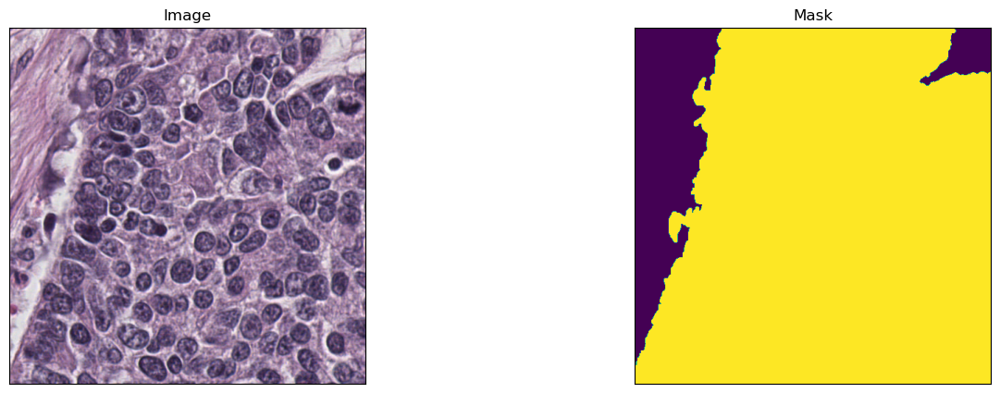

In [7]:
print("Length of dataset: ", len(dataset))
r = randint(0, len(dataset) - 1)
image, masks = dataset[r]

print("Mask unique: ", np.unique(masks))
print("Mask shape: ", masks.shape)
visualize(
	image=image,
	mask=masks
)



# Define the model

In [10]:
class model():
	def __init__(self, arch, backbone, encoder, lr, activation):
		self.arch = arch
		self.backbone = backbone

		# callbacks
		self.checkpoint = tf.keras.callbacks.ModelCheckpoint(
			f'./models/{arch}/{backbone}/best_model.keras',
			monitor='iou_score',
			verbose=1,
			save_best_only=True,
			save_weights_only=False,
			mode='max',
			save_freq='epoch',
			initial_value_threshold=None
		)
		name = arch + "-" + backbone
		self.tensorboard = tf.keras.callbacks.TensorBoard(log_dir=f"logs/{name}")
		
		# loss functions
		dice_loss = sm.losses.DiceLoss(class_weights=np.array([0, 1.1, 1.4, 5.8, 9.4, 0.2]), per_image=True) 
		focal_loss = sm.losses.CategoricalFocalLoss()
		jaccard_loss = sm.losses.JaccardLoss(per_image=True, class_weights=np.array([0, 1.1, 1.4, 5.8, 9.4, 0.2]))
		total_loss = dice_loss + (1 * focal_loss) + jaccard_loss

		# metrices
		metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]
		self.preprocess = sm.get_preprocessing(backbone)

		opt = keras.optimizers.Adam(lr)

		if arch == "Unet":
			self.model = sm.Unet(backbone_name=backbone, encoder_weights=encoder, activation=activation, classes=6, input_shape=(SIZE, SIZE, 3))
			self.model.compile(opt, loss=total_loss, metrics=metrics)
		elif arch == "Linknet":
			self.model = sm.Linknet(backbone_name=backbone, encoder_weights=encoder, activation=activation, classes=6, input_shape=(SIZE, SIZE, 3))
			self.model.compile(opt, loss=total_loss, metrics=metrics)
		else:
			print("Unknown model arch. The model is undefined.")
	

	def summary(self):
		self.model.summary()


	def train(self):
		SET_SIZE = 256
		cnt = 1

		batch_size = 8

		epoch_size = 20
		initial_epoch = 0

		goal = len(dataset)
		for i in tqdm(range(0, goal, SET_SIZE)):
			x_train, y_train, x_val, y_val = dataset.export_split(dataset.images_path[i:i+SET_SIZE], dataset.masks_path[i:i+SET_SIZE], ratio=0.8, cat=True)

			pre_x_train = self.preprocess(x_train)
			pre_x_val = self.preprocess(x_val)

			history = self.model.fit(pre_x_train, y_train,
									validation_data=(pre_x_val, y_val),
									batch_size=batch_size,
									shuffle=True,
									verbose=1,
									initial_epoch=initial_epoch,
									epochs=initial_epoch + epoch_size,
									callbacks=[self.checkpoint, self.tensorboard]
								)

			self.model.save(f'./models/{self.arch}/{self.backbone}/latest_after_{initial_epoch + epoch_size}_epochs.keras')

			cnt += 1
			initial_epoch += epoch_size
	

In [11]:
model = model(arch="Linknet", backbone="resnet34", encoder="imagenet", activation="softmax", lr=0.0001)

In [12]:
model.train()

  0%|          | 0/5 [00:00<?, ?it/s]

Input images and masks shape:  (256, 512, 512, 3) (256, 512, 512, 1)
Epoch 1/20


  0%|          | 0/5 [00:19<?, ?it/s]


KeyboardInterrupt: 

In [9]:
from keras.models import load_model
loaded_model = load_model('./models/Unet/resnet34/latest_after_20_epochs.keras', compile=False)

In [13]:
x_test, y_test, x_empty, y_empty = dataset.export_split(dataset.images_test_path, dataset.masks_test_path, 1, cat=False)
x_test = model.preprocess(x_test)
y_pred = loaded_model.predict(x_test)
y_pred_argmax = np.argmax(y_pred, axis=3)
print(y_pred_argmax.shape, np.unique(y_pred_argmax))

Input images and masks shape:  (50, 512, 512, 3) (50, 512, 512, 1)
2/2 ━━━━━━━━━━━━━━━━━━━━ 9s 3s/step
(50, 512, 512) [0 1 2 3 4 5]


In [14]:
from keras.metrics import MeanIoU
IOU_keras = MeanIoU(num_classes=len(dataset.classes)+1)  
IOU_keras.update_state(y_test[:,:,:,0], y_pred_argmax)
print("Mean IoU =", IOU_keras.result().numpy())
		

Mean IoU = 0.22235437


In [15]:
def gray_to_rgb(x):
    x_reshaped = np.concatenate([x] * 3, axis=-1)
    color_map = {
            1: [255, 0, 0],   # Red for lepidic
            2: [0, 255, 0],   # Green for acinar
            3: [0, 0, 255],    # Blue for micropapillary
            4: [255, 255, 0],  # Yellow for papillary
            5: [255, 0, 255],   # violet for solid
        }
    
    rgb = np.zeros_like(x_reshaped, dtype=np.uint8)
    for label, color in color_map.items():
            rgb[x_reshaped[..., 0] == label] = color 
    return rgb

In [16]:
# Convert to colors according to classes
y_test_rgb = gray_to_rgb(y_test)
y_pred_argmax_expanded = np.expand_dims(y_pred_argmax, axis=-1)
y_pred_argmax_rgb = gray_to_rgb(y_pred_argmax_expanded)

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


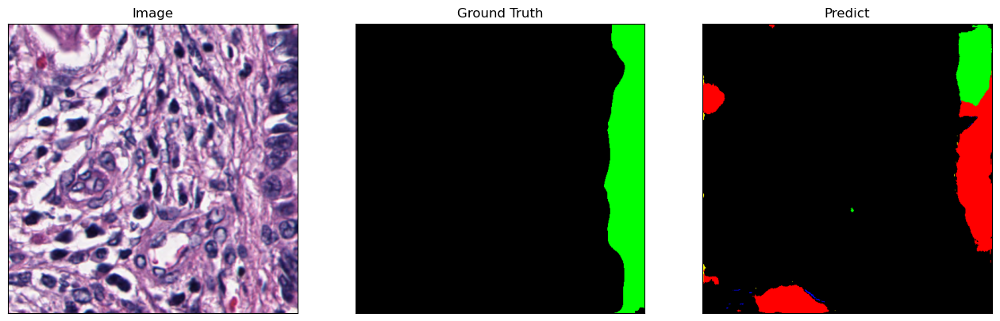

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


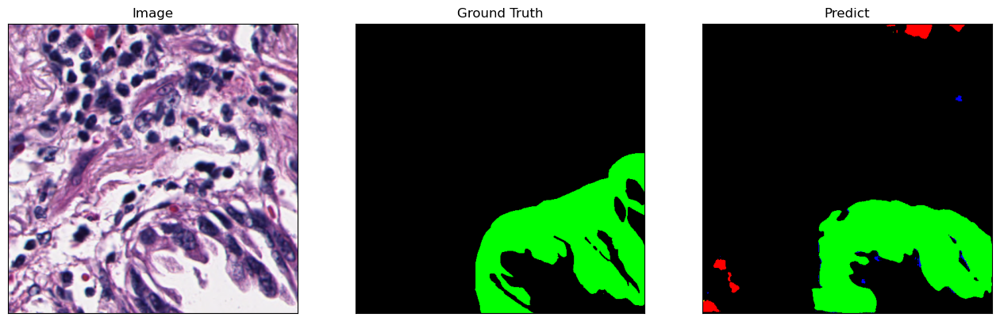

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


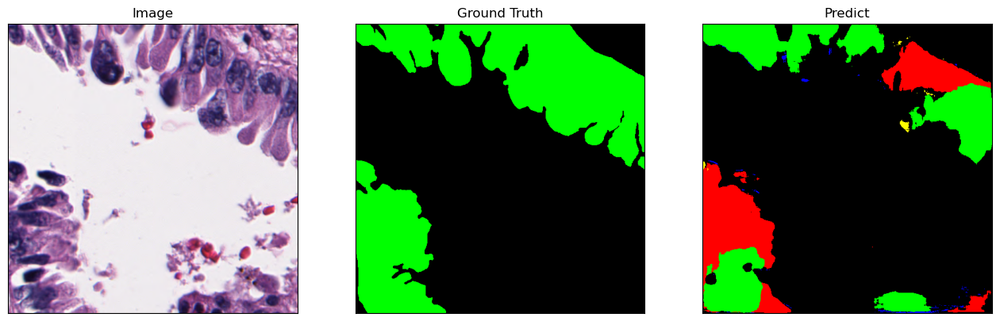

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


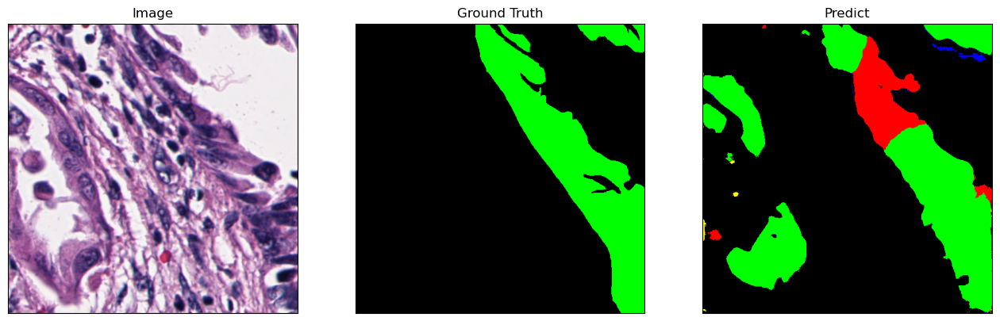

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


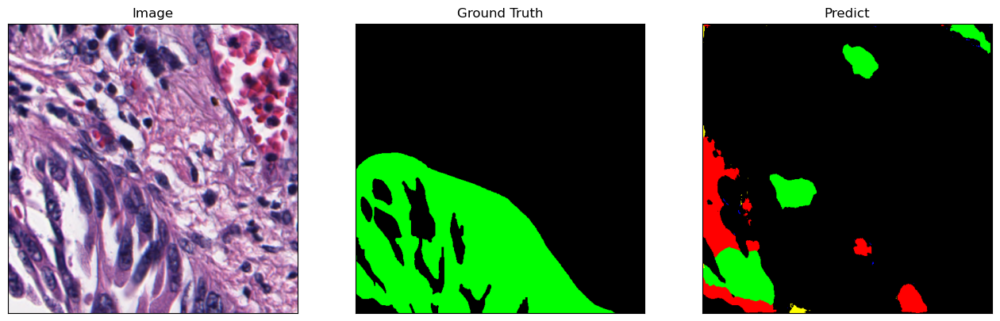

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


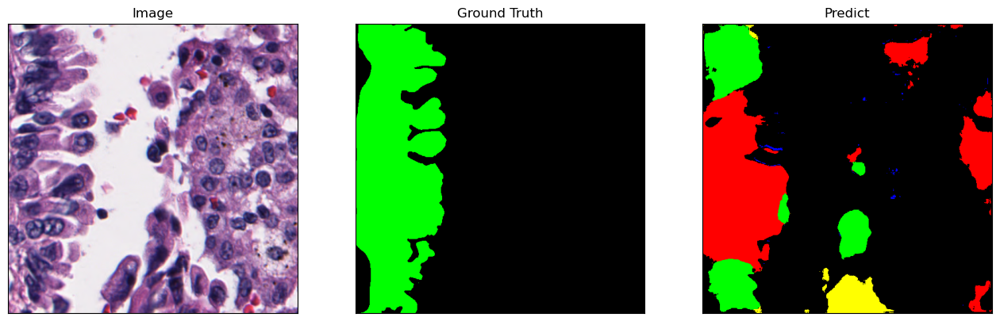

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


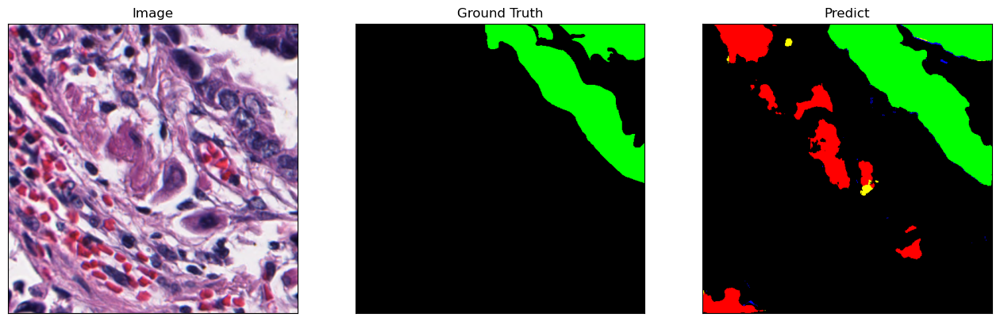

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


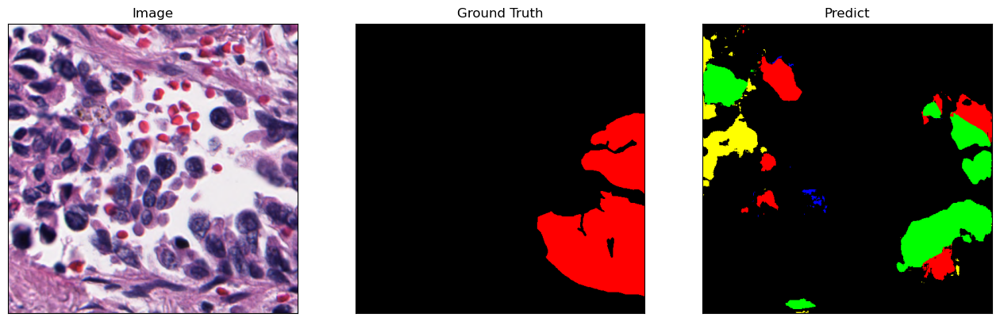

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


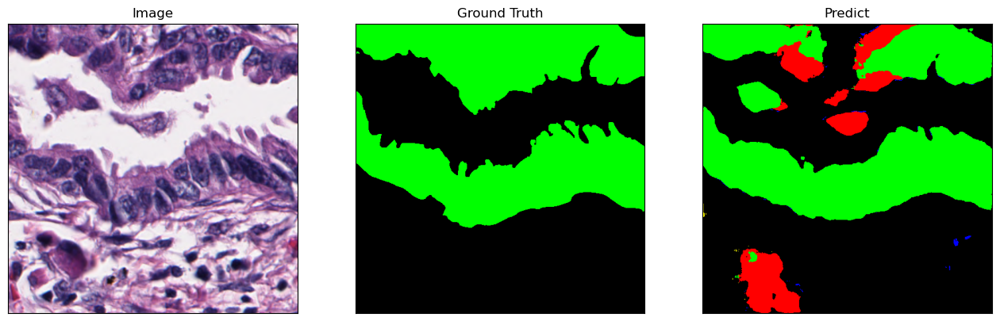

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


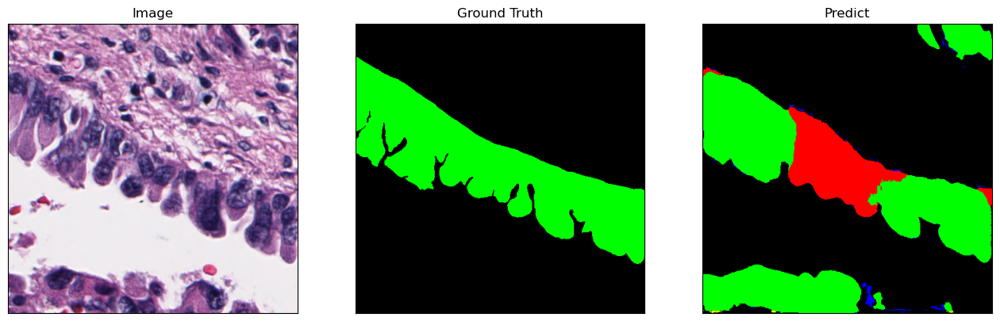

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


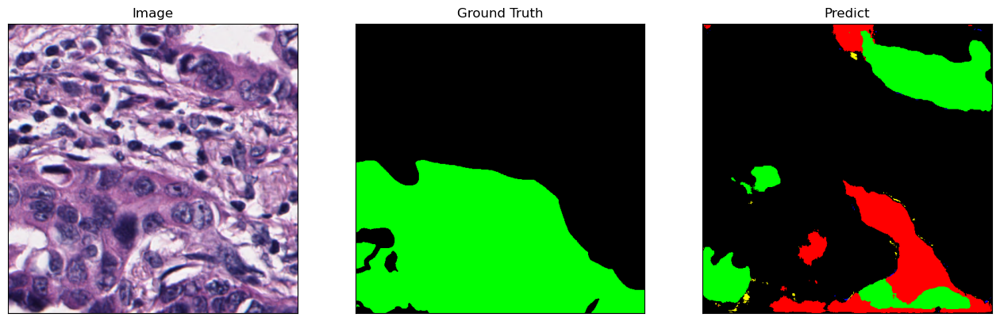

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


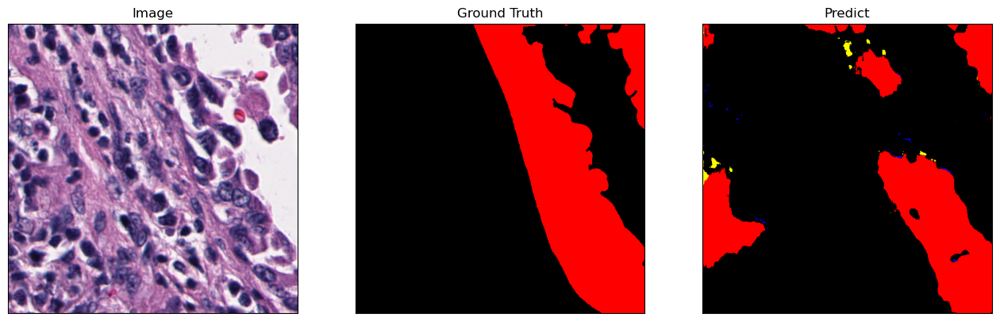

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


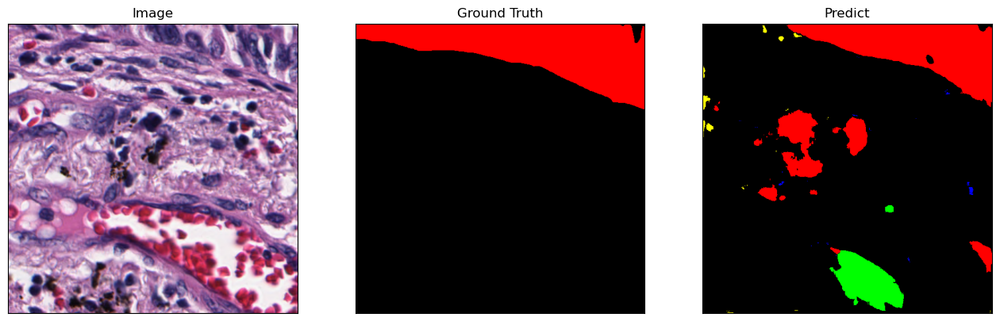

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


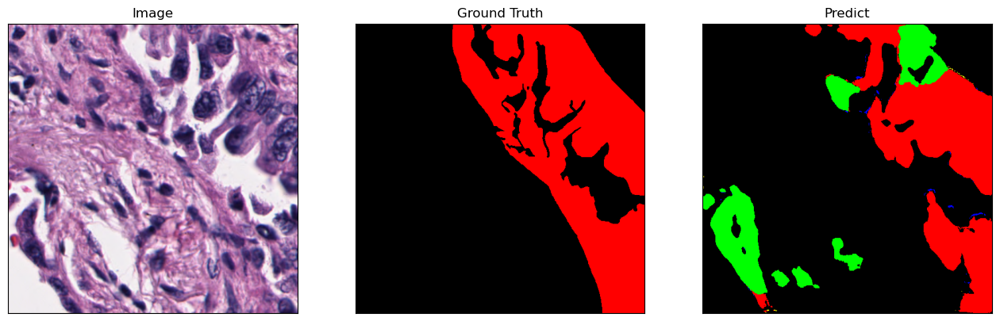

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


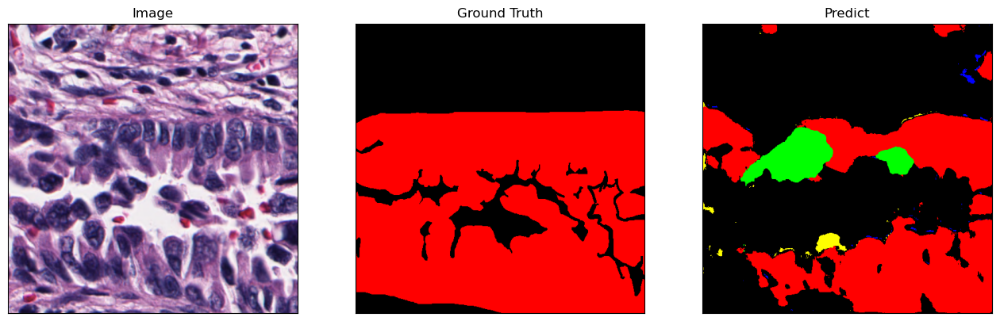

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


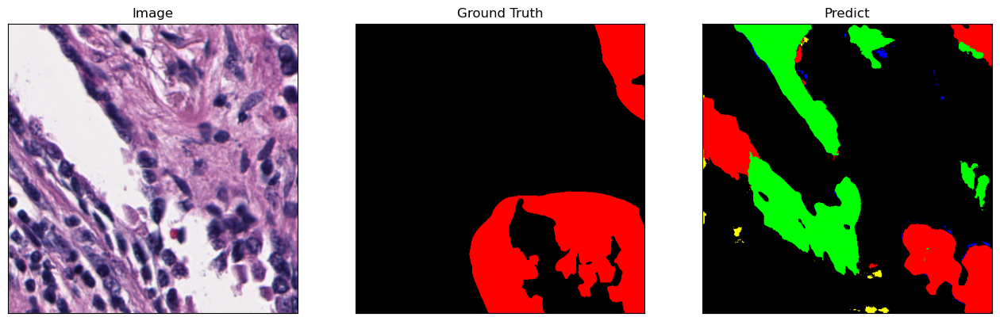

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


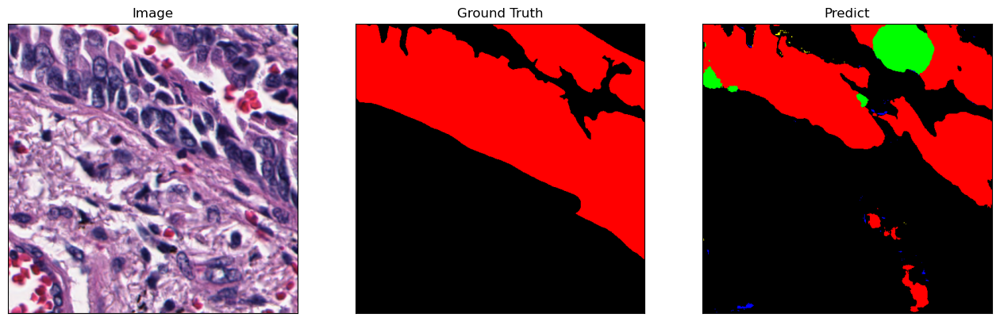

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


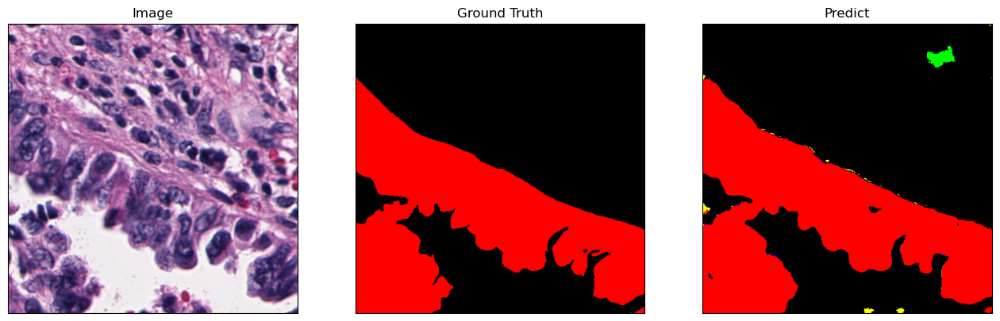

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


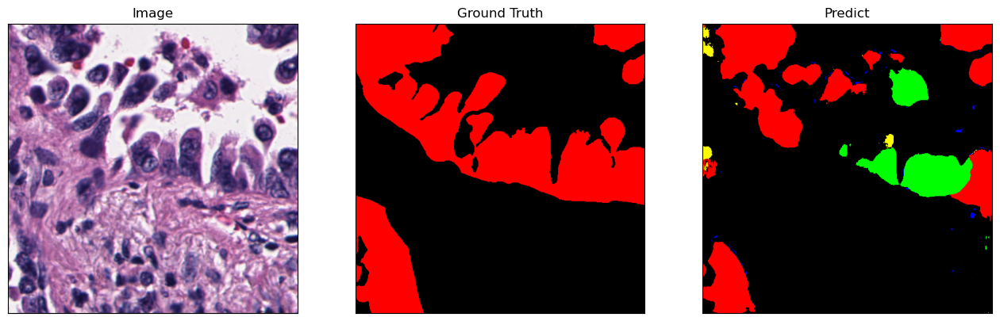

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


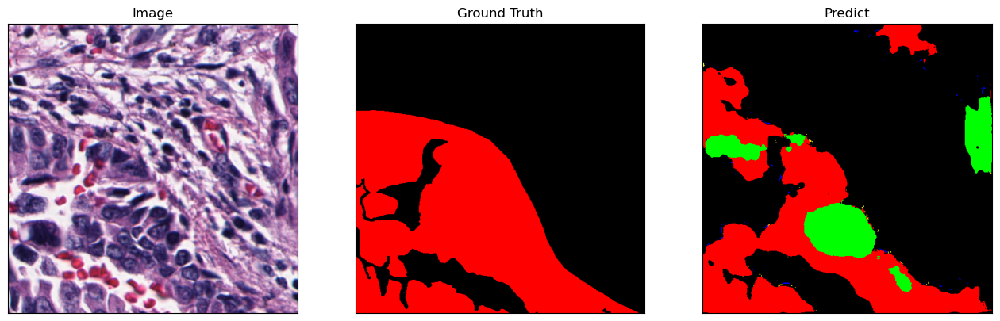

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


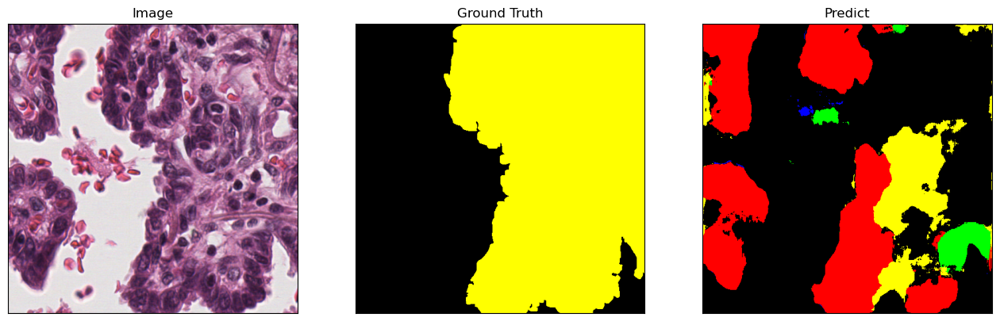

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


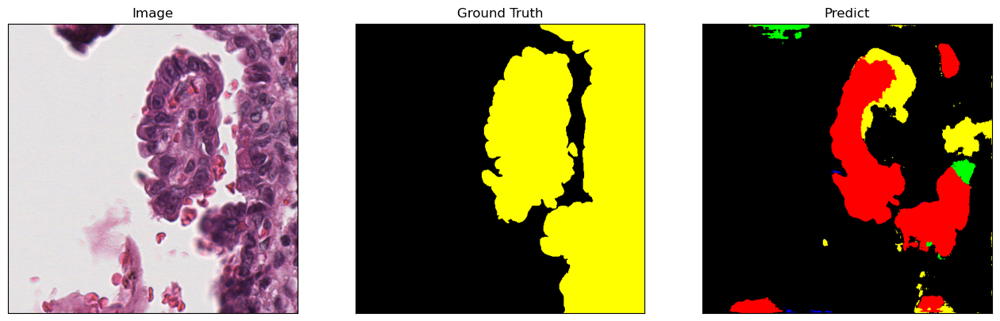

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


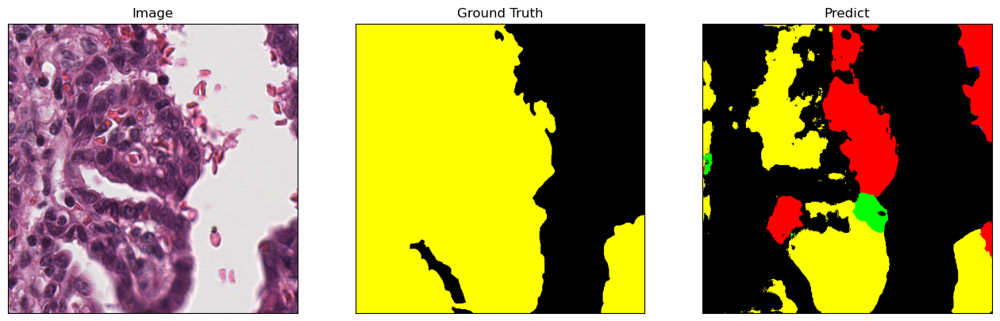

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


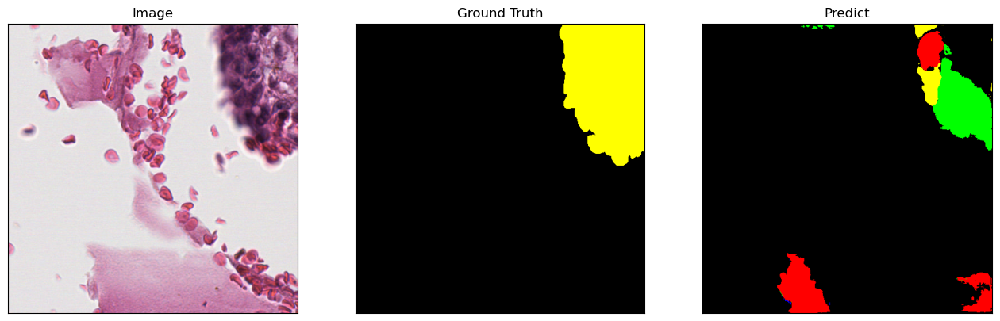

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


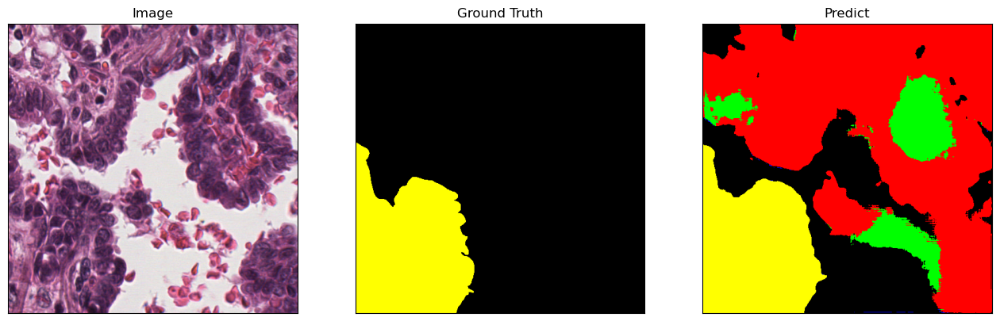

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


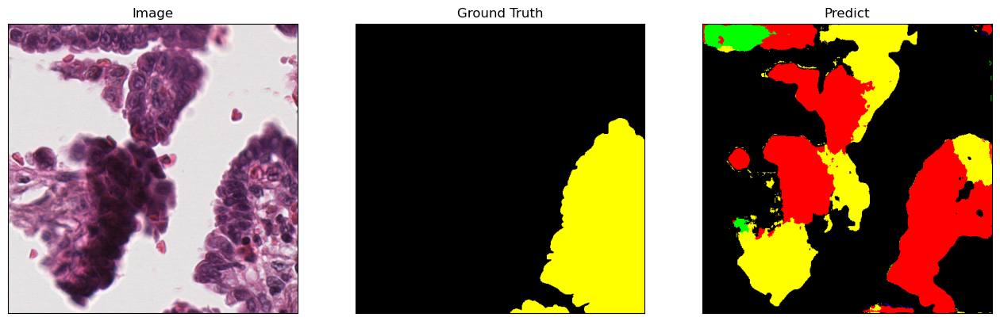

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


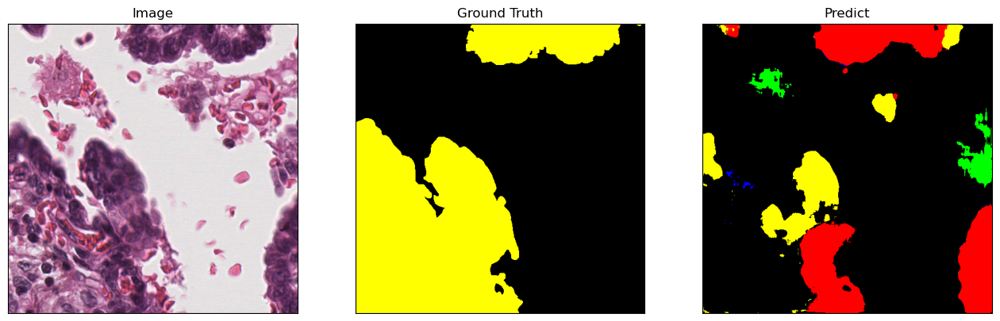

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


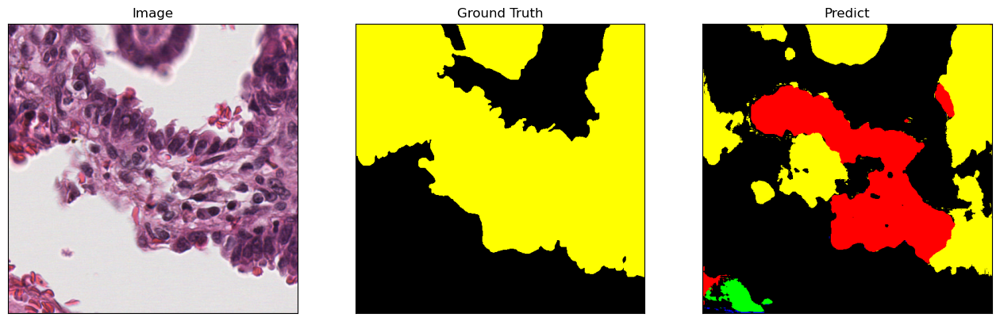

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


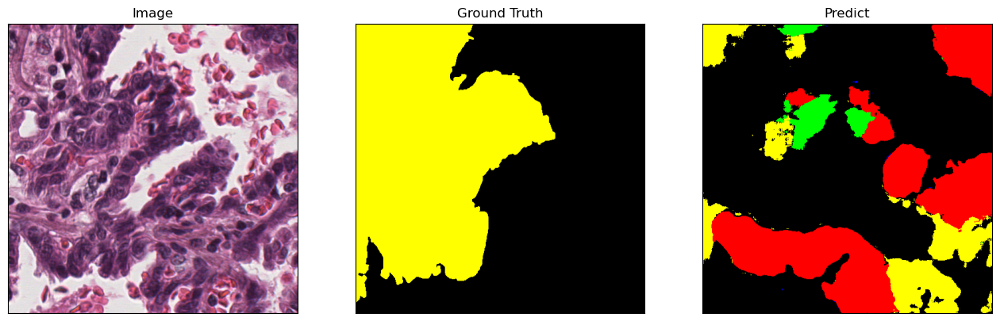

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


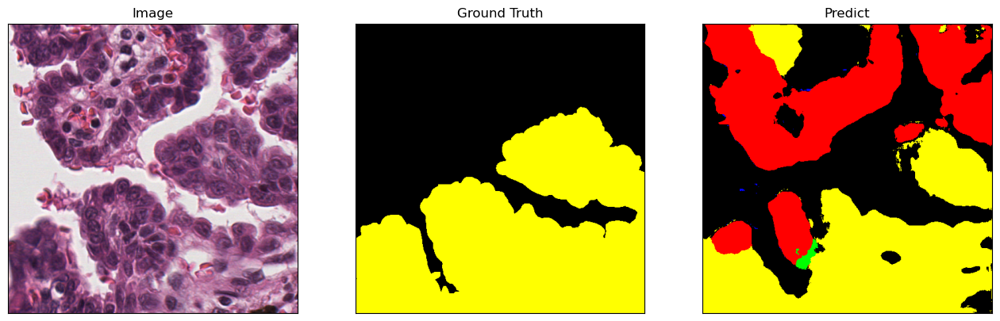

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


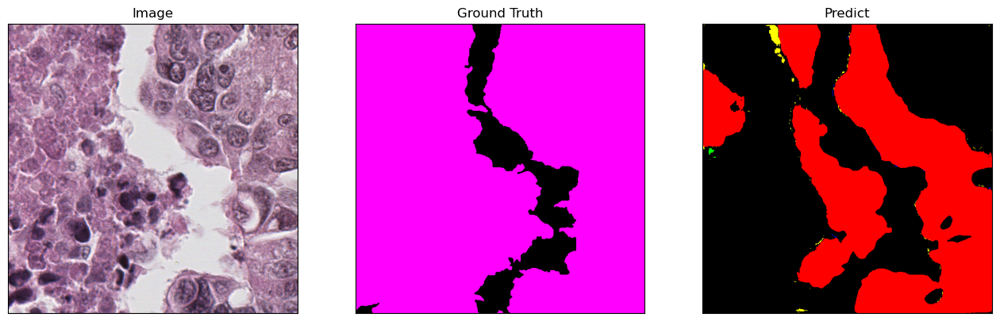

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


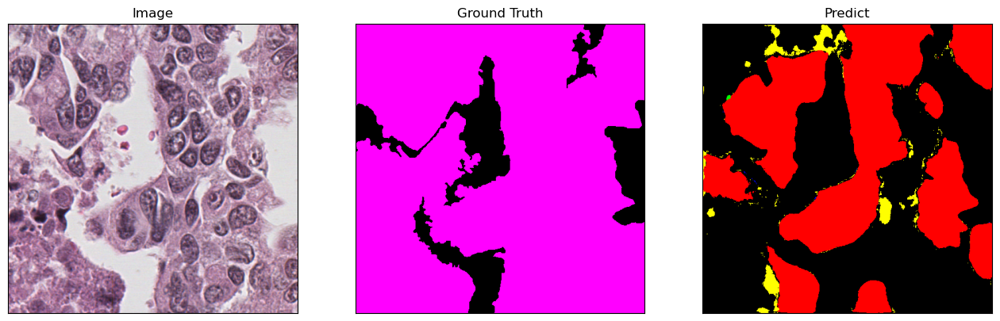

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


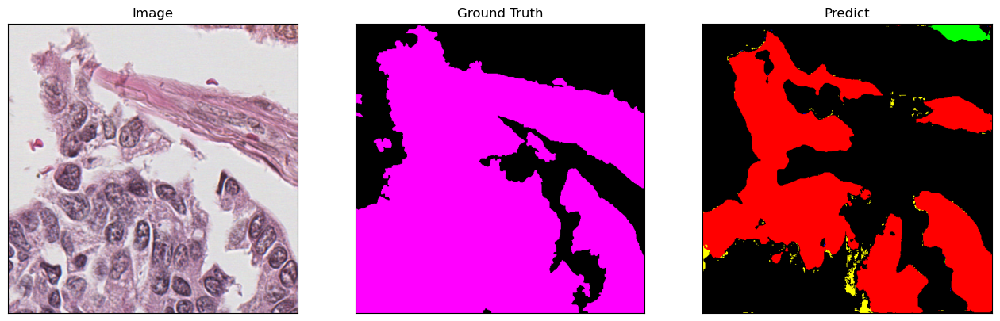

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


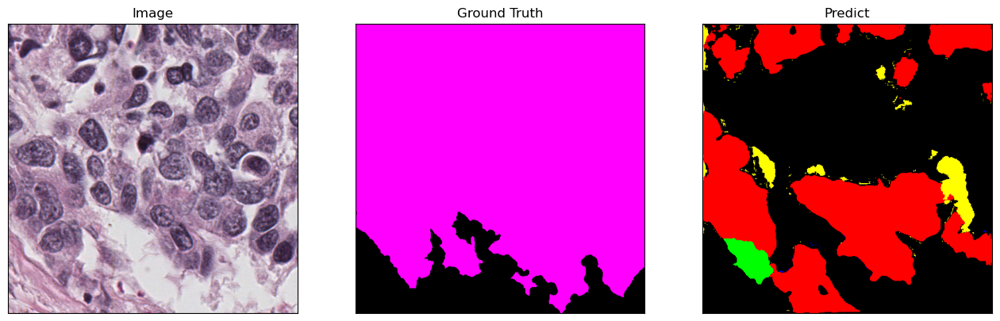

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


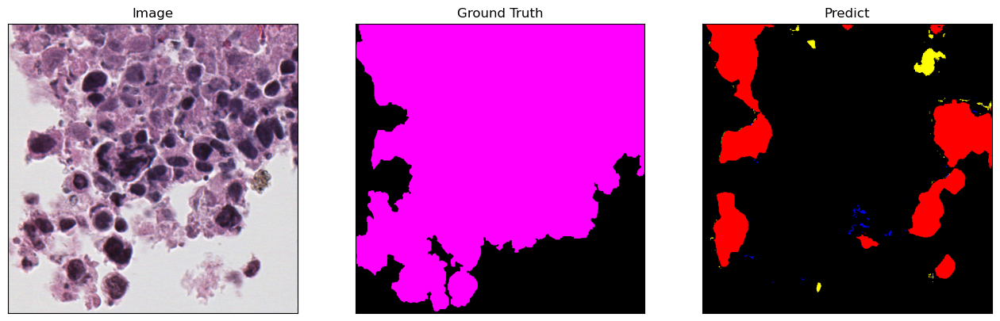

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 3 4]


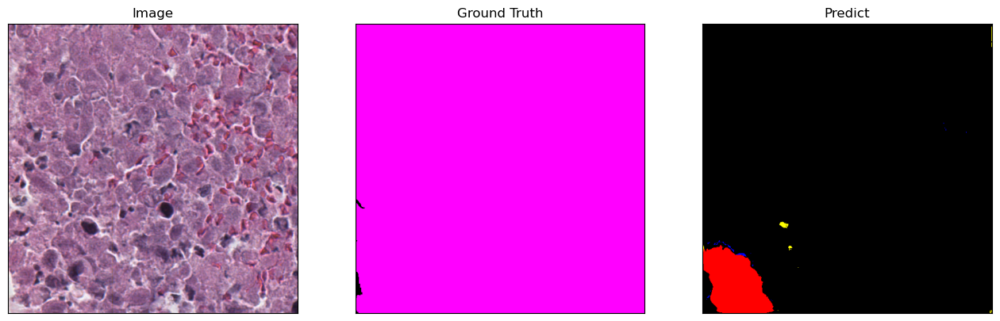

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


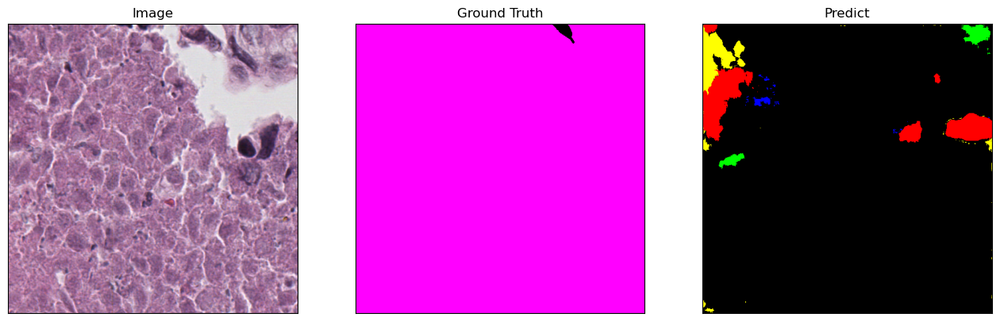

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


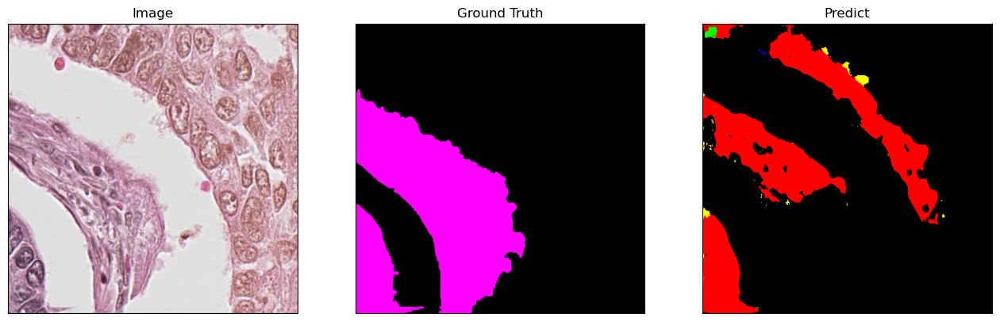

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


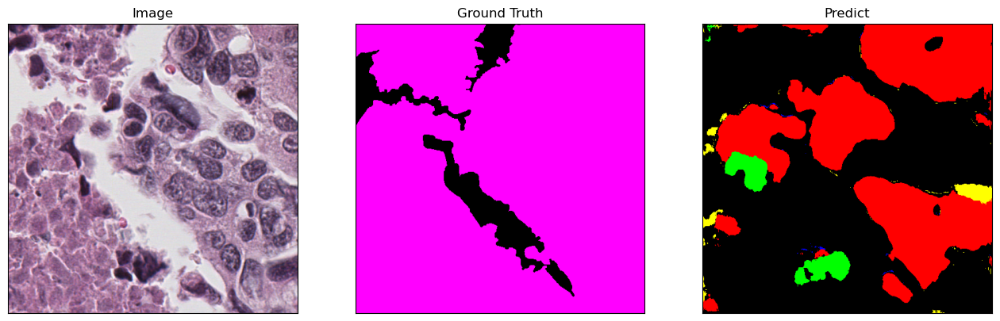

y_test shape:  (50, 512, 512, 1)
y_test unique:  [5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


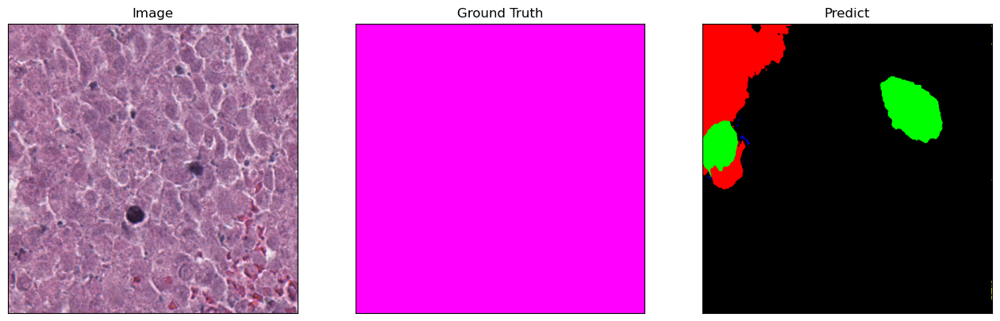

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


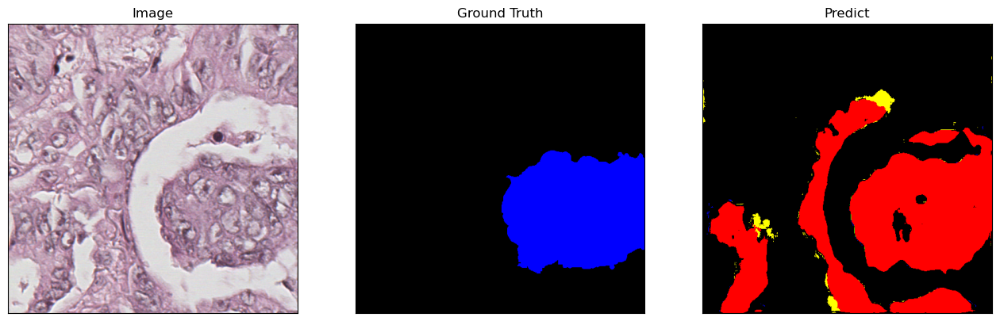

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


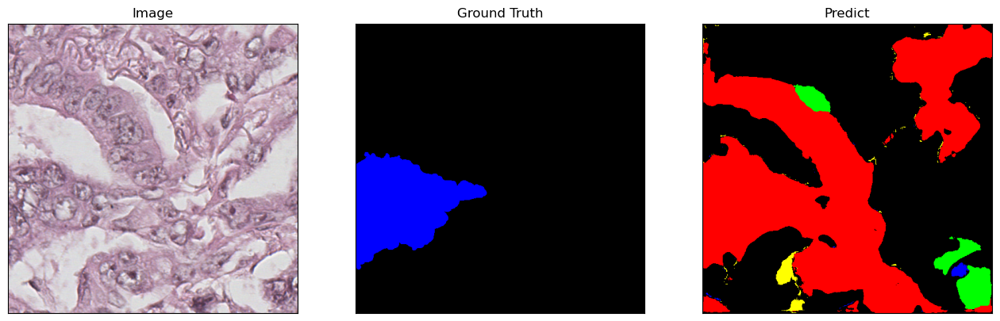

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


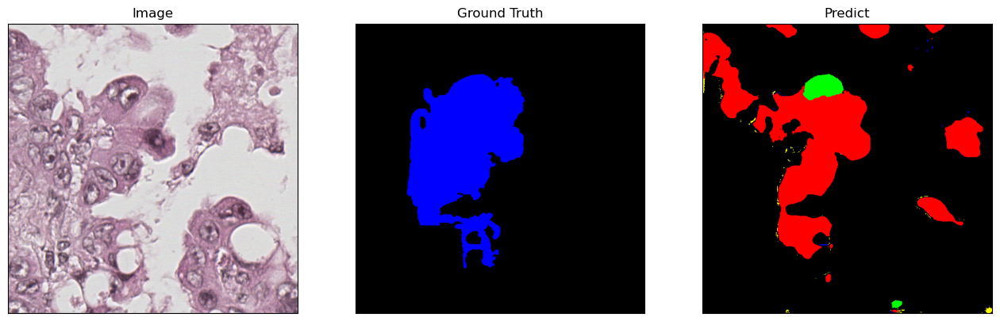

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


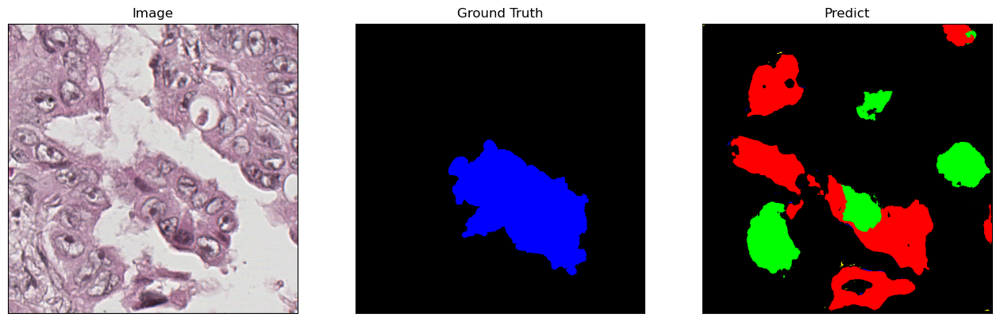

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


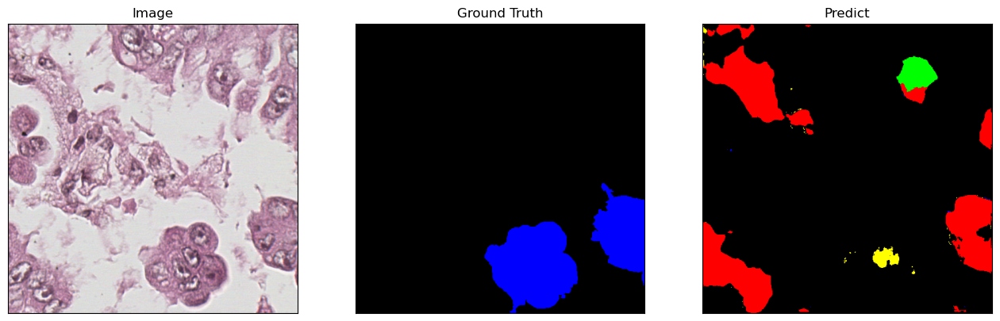

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 3 4]


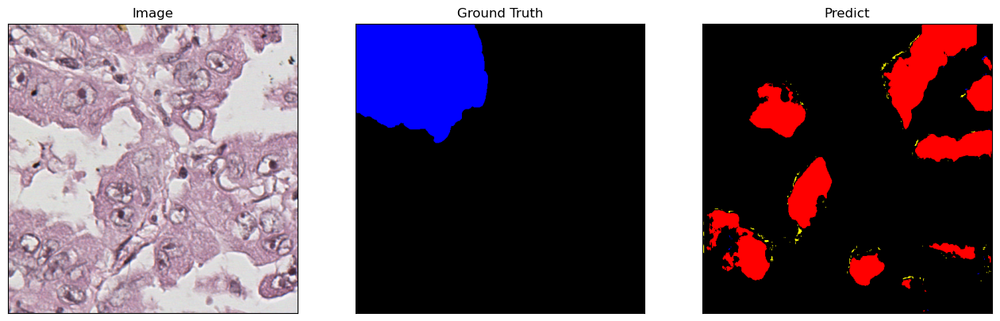

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


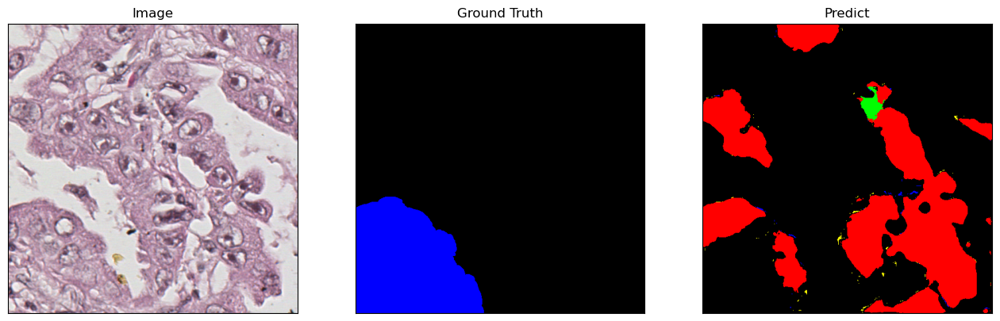

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


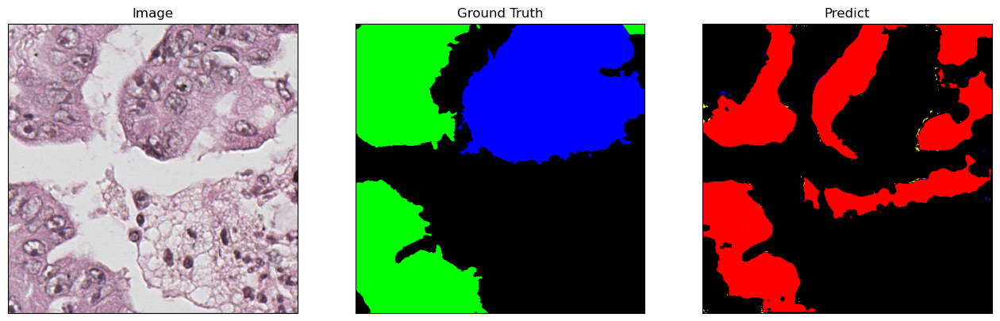

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4 5]


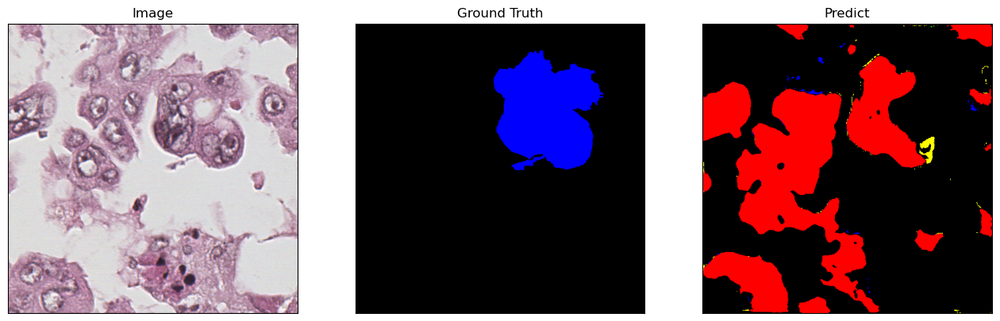

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 3 4]


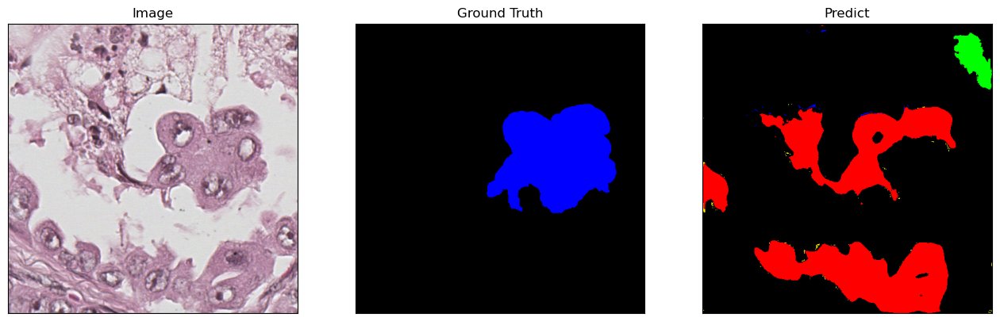

In [17]:

idx = randint(0, len(x_test)-1)
# idx = 16

for idx in range(len(x_test)):
	print("y_test shape: ", y_test.shape)
	print("y_test unique: ", np.unique(y_test[idx]))
	print("y_pred_argmax_rgb shape: ", y_pred_argmax_rgb.shape)
	print("y_pred_argmax shape: ", y_pred_argmax.shape)
	print("y_pred_argmax unique: ", np.unique(y_pred_argmax[idx]))
	visualize(
		image=x_test[idx],
		ground_truth=y_test_rgb[idx],
		predict=y_pred_argmax_rgb[idx],
	)

# array = np.full((50, 512, 512, 1), 2)
# array_rgb = gray_to_rgb(array)

# st = np.concatenate([array]*3,axis=-1)
# print(st.shape)
# # print(st)

# Red for lepidic
# Green for acinar
# Blue for micropapillary
# Yellow for papillary
# violet for solid